# Основные выводы по результатам проведенного EDA

*Решил для удобства в самом начале привести резюме своих исследований и наблюдений. Код на основе которых были получены мои выводы приведен ниже*

## EDA

###  1. Однофакторный анализ и работа по "исправлению" и "выравниванию" датасета
 Однофакторный анализ и работа по "исправлению" и "выравниванию" датасета строилась мной на основе анализа полученного ProfileReport (далее PR).
 Я выделил следующие проблемы по итогам анализа PR:
 - дубликаты 
- пропущенные и нулевые значения
- проблемы в распределении признаков и целевой переменной
- работа с выбросами
- сильные парные корреляции между признаками
 
#### * Дубликаты
Как показывает ProfileReport, в таблице есть дубли. С учетом того, что в строках нет уникального идентификатора, возможно это разные наблюдения, давшие одинаковый результат. Однако принял решение избавиться от дублей, с учетом того, что их удельный вес крайне невелик.


#### * Пропущенные и нулевые значения
Нулевые и отсутствующие значения присутствуют в колонках, которые в действительности могут быть нулевыми: колонки, связанные с количеством посвященных страниц определенного типа, и временем, которые пользователь провёл на данной странице. Данные страницы представляют интерес для магазинов, так как напрямую связаны с покупками и удельный вес нулевых данных в общих данных огромен (от 40 до 90 процентов от общих значений в таких колонках). В этой связи принял два решения:
- не избавляться от записей, содержащих нулевые значения;
- удалить все NaN значения: их удельный вес крайне мал, а заполнение NaN наиболее частым значением или медианой не даст осмысленности данным (заполнение будет в этих подходах нулями, а интерес для онлайн-магазинов представляют собой покупатели, имеющие ненулевые показатели посещаемости страниц и их продолжительности.

#### * Распределение признаков и целевой переменной
Целевая переменная Revenue представляет собой булевой категориальный признак, указывающий на то, была ли совершена покупка или нет. Мы закодировали его значение в нуль и единицу и построили гистограмму распределения, которая выявила потенциальную проблема при построении моделей предсказания данной целевой переменной: несбалансированность (примерно 20/80). При таком распределении целевой переменной без применения специальных приёмов по выравниванию, с большой степенью вероятности модель будет выдавать прогноз 0 (отсутствие покупки), основываясь на частотности данного значения.

С распределением признаков значимых проблем не обнаружил, за исключением данных в ExitRates и BounceRates. Анализ графиков распределения признаков в ProfileReport выявил наличие выбросов, которые убрал путем отсечения данных выше квантилей 0.95. С получившимся распределением можно работать в машинном обучении: логарифмирование с добавлением единицы позволит получить нормальное распределение данных величин.

#### * Сильные парные корреляции между признаками
Заметил, что ProfileReport показывает наличие сильных корреляции между следующими числовыми признаками: df.Administrative и df.Administrative_Duration, df.Informational и df.Informational_Duration, df.ProductRelated и df.ProductRelated_Duration, df.BounceRates и df.ExitRates. При этом время проведения пользователем на целевых страницах кажется более содержательным признаком, чем количество посещенных целевых страниц. В этой связи, при оценке корреляции между целевой переменной и числовыми признаками, исключил связанные коррелирующие признаки df.Administrative, df.Informational, df.ProductRelated. Не смог оценить сравнительную важность между df.BounceRates и df.ExitRates, поэтому для дальнейшей работы оставил оба признака.

#### * Прочие манипуляции
Перекодировал булевые категориальные признаки в единицы и нули, также поступил с целевой переменной Revenue, переименовал её в столбец 'y'. Пока не стал кодировать через OHE прочие категориальные признаки: задача такая не ставилась, и не факт что это будет лучшим подходом в работе с категориалкой, нужно изучать поглубже.

### 2. Оценка корреляций
Построил корреляции между числовыми признаками (корреляция Пирсона), между категориальными (V-мера Крамера) и между числовыми и категориальными (Anova), построил визуализацию первых двух корреляций.
Корреляция Пирсона показала наибольшую корреляцию целевой переменной с PageValues и ProductRelated_Duration, V-мера Крамера показала значимость месяца года (сделал предположение, что это может быть связано с наличием большого числа праздников в определенные месяцы года). Anova говорит, что присутствует взаимосвязь между всеми числовыми и категориальными значениями. 

## Pandas Vs Polars
При оценки скорости работы данных библиотек на нашем датасете обнаружилось преимущество Polars в загрузке датасета и простой выборке сабсетов, но с точки зрения сложной и фильтрации и агрегации Pandas на моем компьютере неожиданно оказался быстрее. Еще более удивительным мне показался факт, что lazy-агрегация Polars не дала преимуществ по сравнению с обычной агрегацией. Такое ощущение, что результаты в работе библиотек слишком сильно зависят от набора данных, железа и версии этих библиотек.
  

## Загрузка датасета и его общие характеристики

In [1]:
import numpy as np
import pandas as pd

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/aiedu-courses/stepik_eda_and_dev_tools/main/datasets/online_shoppers_intention.csv')

In [3]:
df.shape

(12330, 18)

**All features**

| Feature                   | Description                                                                                                | Type             |
|---------------------------|------------------------------------------------------------------------------------------------------------|------------------|
| `Revenue`                 | TARGET LABEL: whether the visitor made a purchase (True) or not (False)                                    | Categorical, boolean   |
| `Administrative`          | the number of pages of this type (administarive) that the user visited                                     | Numerical, int   |
| `Administrative_Duration` | the amount of time spent in this category (administarive) of pages                                         | Numerical, float |
| `Informational`           | the number of pages of this type (informational) that the user visited                                     | Numerical, int   |
| `Informational_Duration`  | the amount of time spent in this category (informational) of pages                                         | Numerical, float |
| `ProductRelated`          | the number of pages of this type (product related) that the user visited                                   | Numerical, int   |
| `ProductRelated_Duration` | the amount of time spent in this category (product related) of pages                                       | Numerical, float |
| `BounceRates`             | the percentage of visitors who enter the website through that page and exit without triggering any additional tasks (characteristic of Google Analytics)                  | Numerical, float |
| `ExitRates`               | the percentage of pageviews on the website that end at that specific page (characteristic of Google Analytics)                    | Numerical, float  |
| `PageValues`              | the average value of the page averaged over the value of the target page and/or the completion of an eCommerce (characteristic of Google Analytics)                    | Numerical, float |
| `SpecialDay`              | the closeness of the visiting site to a specific special day (e.g. Mother's Day)                           | Numerical, float |
| `Month`                   | the month of the year of the visiting site                                                                 | Categorical, object |
| `OperatingSystems`        | user's operating system                                                                                    | Categorical, int |
| `Browser`                 | user's browser                                                                                             | Categorical, int |
| `Region`                  | user's region                                                                                              | Categorical, int |
| `TrafficType`             | the type of traffic the brought the visitor to the website                                                 | Categorical, int |
| `VisitorType`             | visitor type (Returning_Visitor or New_Visitor or Other)                                                   | Categorical, object |
| `Weekend`                 | is the visit day a weekend                                                                                 | Categorical, boolean |

In [10]:
df.describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,OperatingSystems,Browser,Region,TrafficType
count,12330.000000,12330.000000,12330.000000,12131.000000,12330.000000,11839.000000,12330.000000,12231.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000
mean,2.315166,80.818611,0.503569,34.724502,31.731468,1190.534914,0.022191,0.043021,5.889258,0.061427,2.124006,2.357097,3.147364,4.069586
std,3.321784,176.779107,1.270156,141.655684,44.475503,1908.447706,0.048488,0.048562,18.568437,0.198917,0.911325,1.717277,2.401591,4.025169
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,7.000000,183.854167,0.000000,0.014286,0.000000,0.000000,2.000000,2.000000,1.000000,2.000000
50%,1.000000,7.500000,0.000000,0.000000,18.000000,597.625000,0.003112,0.025141,0.000000,0.000000,2.000000,2.000000,3.000000,2.000000
75%,4.000000,93.256250,0.000000,0.000000,38.000000,1462.554562,0.016813,0.050000,0.000000,0.000000,3.000000,2.000000,4.000000,4.000000
max,27.000000,3398.750000,24.000000,2549.375000,705.000000,63973.522230,0.200000,0.200000,361.763742,1.000000,8.000000,13.000000,9.000000,20.000000


In [43]:
df.describe(include='object')

,Month,VisitorType
count,11448,11448
unique,11,3
top,May,Returning_Visitor
freq,3111,9797


In [12]:
df.sample(5)

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
11167,0,0.000000,0,0.0,2,0.00000,0.100000,0.200000,0.0,0.0,Nov,2,2,1,1,Returning_Visitor,False,False
10735,2,14.000000,0,0.0,5,NaN,0.000000,0.038095,0.0,0.0,Dec,2,2,1,2,Returning_Visitor,False,False
9498,0,0.000000,0,0.0,65,3873.02197,0.014394,0.019913,0.0,0.0,Nov,3,2,1,2,Returning_Visitor,True,True
10045,0,0.000000,0,NaN,4,213.50000,0.000000,0.100000,0.0,0.0,Dec,2,10,9,1,Returning_Visitor,False,False
8287,4,643.833333,0,0.0,17,508.25000,0.031579,0.052632,0.0,0.0,Nov,2,4,1,1,Returning_Visitor,False,False


In [4]:
df.isna().sum()

Administrative               0
Administrative_Duration      0
Informational                0
Informational_Duration     199
ProductRelated               0
ProductRelated_Duration    491
BounceRates                  0
ExitRates                   99
PageValues                   0
SpecialDay                   0
Month                        0
OperatingSystems             0
Browser                      0
Region                       0
TrafficType                  0
VisitorType                  0
Weekend                      0
Revenue                      0
dtype: int64

## Профиль-репорт исходного датасета

In [62]:
from ydata_profiling import ProfileReport

In [9]:
ProfileReport(df, title = 'Profiling Report of the Shoppers Intention Dataset',
                html = {'style':{'full_width':True}})

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

На вкладке alerts мы видим 20 выявленных проблем. Сгруппируем их по однородности и выработаем метод работы с каждой группой.

# Дубликаты

Как показывает ProfileReport, в таблице есть дубли. С учетом того, что в строках нет уникального идентификатора, возможно эти наблюдения разные. Однако принял решение избавиться от дублей, с учетом того, что их удельный вес крайне невелик.

In [12]:
df[~df.duplicated()]

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,Feb,1,1,1,1,Returning_Visitor,False,False
1,0,0.0,0,0.0,2,64.000000,0.000000,0.100000,0.000000,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
2,0,0.0,0,0.0,1,0.000000,0.200000,0.200000,0.000000,0.0,Feb,4,1,9,3,Returning_Visitor,False,False
3,0,0.0,0,0.0,2,2.666667,0.050000,0.140000,0.000000,0.0,Feb,3,2,2,4,Returning_Visitor,False,False
4,0,0.0,0,0.0,10,627.500000,0.020000,0.050000,0.000000,0.0,Feb,3,3,1,4,Returning_Visitor,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12325,3,145.0,0,0.0,53,1783.791667,0.007143,0.029031,12.241717,0.0,Dec,4,6,1,1,Returning_Visitor,True,False
12326,0,0.0,0,0.0,5,465.750000,0.000000,0.021333,0.000000,0.0,Nov,3,2,1,8,Returning_Visitor,True,False
12327,0,0.0,0,0.0,6,184.250000,0.083333,0.086667,0.000000,0.0,Nov,3,2,1,13,Returning_Visitor,True,False
12328,4,75.0,0,0.0,15,346.000000,0.000000,0.021053,0.000000,0.0,Nov,2,2,3,11,Returning_Visitor,False,False


In [14]:
df.drop_duplicates(keep='last', inplace=True)

In [15]:
df.shape

(12221, 18)

# Отсутствующие данные (пропущенные и нулевые значения)

Нулевые и отсутствующие значения присутствуют в колонках, которые в действительности могут быть нулевыми: колонки, связанные с количеством посвященных страниц определенного типа, и временем, которые пользователь провёл на данной странице. Данные страницы представляют интерес для магазинов, так как напрямую связаны с покупками и удельный вес нулевых данных в общих данных огромен (от 40 до 90 процентов от общих значений в таких колонках). В этой связи принял два решения:
- не избавляться от записей, содержащих нулевые значения;
- удалить все NaN значения: их удельный вес крайне мал, а заполнение NaN наиболее частым значением или медианой не даст осмысленности данным (заполнение будет в этих подходах нулями, а интерес для онлайн-магазинов представляют собой покупатели, имеющие ненулевые показатели посещаемости страниц и их продолжительности.  

In [16]:
df.isna().sum()

Administrative               0
Administrative_Duration      0
Informational                0
Informational_Duration     199
ProductRelated               0
ProductRelated_Duration    489
BounceRates                  0
ExitRates                   99
PageValues                   0
SpecialDay                   0
Month                        0
OperatingSystems             0
Browser                      0
Region                       0
TrafficType                  0
VisitorType                  0
Weekend                      0
Revenue                      0
dtype: int64

In [34]:
df[df.Informational_Duration.isna()]

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
19,0,0.000000,0,NaN,20,2981.166667,0.000000,0.010000,0.0,0.0,Feb,2,4,4,4,Returning_Visitor,False,False
130,0,0.000000,0,NaN,2,222.000000,0.000000,0.100000,0.0,0.0,Feb,2,6,1,2,Returning_Visitor,True,False
134,6,111.500000,0,NaN,26,449.027778,0.000000,0.018519,0.0,0.6,Feb,1,1,3,3,Returning_Visitor,False,False
158,0,0.000000,0,NaN,1,0.000000,0.200000,0.200000,0.0,0.0,Feb,1,1,1,3,Returning_Visitor,False,False
197,3,112.960784,0,NaN,13,3014.018519,0.013068,0.061406,0.0,0.0,Mar,2,2,1,2,Returning_Visitor,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11934,0,0.000000,0,NaN,1,0.000000,0.200000,0.200000,0.0,0.0,Dec,1,1,1,2,New_Visitor,False,False
12126,0,0.000000,0,NaN,18,636.500000,0.000000,0.027778,0.0,0.0,Dec,2,2,3,2,Returning_Visitor,False,False
12176,6,1489.041667,0,NaN,12,879.800000,0.000000,0.005556,0.0,0.0,Nov,2,2,4,2,New_Visitor,True,False
12208,0,0.000000,0,NaN,15,264.083333,0.000000,0.020000,0.0,0.0,Nov,2,2,2,1,Returning_Visitor,False,False


In [35]:
df[df.ProductRelated_Duration.isna()]

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
30,0,0.000000,0,0.0,2,NaN,0.000000,NaN,0.000000,0.0,Feb,1,1,6,3,Returning_Visitor,False,False
35,0,0.000000,0,0.0,52,NaN,0.015385,0.020353,0.000000,0.0,Feb,2,2,7,1,Returning_Visitor,False,False
107,0,0.000000,0,0.0,12,NaN,0.050000,0.066667,0.000000,0.0,Feb,1,1,1,3,Returning_Visitor,False,False
120,0,0.000000,0,0.0,6,NaN,0.000000,0.033333,0.000000,0.0,Feb,2,4,4,1,Returning_Visitor,False,False
124,0,0.000000,0,0.0,11,NaN,0.028000,0.119524,0.000000,0.0,Feb,2,4,3,1,Returning_Visitor,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12188,7,533.591353,4,333.5,85,NaN,0.010193,0.025284,5.145929,0.0,Nov,3,2,1,13,Returning_Visitor,False,False
12197,0,0.000000,0,0.0,3,NaN,0.200000,0.200000,0.000000,0.0,Nov,3,2,1,10,Returning_Visitor,False,False
12215,0,0.000000,2,120.5,54,NaN,0.008929,0.025119,0.000000,0.0,Dec,1,1,1,2,Returning_Visitor,False,False
12230,6,580.333333,0,0.0,43,NaN,0.018367,0.018160,0.000000,0.0,Nov,1,1,3,2,Returning_Visitor,False,True


In [37]:
df.dropna(inplace=True)

In [38]:
df.shape

(11448, 18)

In [54]:
df.isna().sum()

Administrative             0
Administrative_Duration    0
Informational              0
Informational_Duration     0
ProductRelated             0
ProductRelated_Duration    0
BounceRates                0
ExitRates                  0
PageValues                 0
SpecialDay                 0
Month                      0
OperatingSystems           0
Browser                    0
Region                     0
TrafficType                0
VisitorType                0
Weekend                    0
Revenue                    0
y                          0
dtype: int64

In [53]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11448 entries, 0 to 12329
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           11448 non-null  int64  
 1   Administrative_Duration  11448 non-null  float64
 2   Informational            11448 non-null  int64  
 3   Informational_Duration   11448 non-null  float64
 4   ProductRelated           11448 non-null  int64  
 5   ProductRelated_Duration  11448 non-null  float64
 6   BounceRates              11448 non-null  float64
 7   ExitRates                11448 non-null  float64
 8   PageValues               11448 non-null  float64
 9   SpecialDay               11448 non-null  float64
 10  Month                    11448 non-null  object 
 11  OperatingSystems         11448 non-null  int64  
 12  Browser                  11448 non-null  int64  
 13  Region                   11448 non-null  int64  
 14  TrafficType              11

In [47]:
df.describe(include='all')

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
count,11448.000000,11448.000000,11448.000000,11448.000000,11448.000000,11448.000000,11448.000000,11448.000000,11448.000000,11448.000000,11448,11448.000000,11448.000000,11448.000000,11448.000000,11448,11448,11448
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11,NaN,NaN,NaN,NaN,3,2,2
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,May,NaN,NaN,NaN,NaN,Returning_Visitor,False,False
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3111,NaN,NaN,NaN,NaN,9797,8761,9678
mean,2.329403,81.989976,0.508036,35.053140,31.860150,1201.987702,0.020451,0.041554,5.845062,0.061897,NaN,2.121157,2.358927,3.150245,4.076607,NaN,NaN,NaN
std,3.323411,179.596871,1.275025,142.947864,44.406423,1919.235363,0.045489,0.046325,18.165430,0.199208,NaN,0.906234,1.712858,2.401144,4.020671,NaN,NaN,NaN
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,1.000000,1.000000,1.000000,1.000000,NaN,NaN,NaN
25%,0.000000,0.000000,0.000000,0.000000,7.750000,190.937500,0.000000,0.014285,0.000000,0.000000,NaN,2.000000,2.000000,1.000000,2.000000,NaN,NaN,NaN
50%,1.000000,9.000000,0.000000,0.000000,18.000000,605.644444,0.002941,0.025000,0.000000,0.000000,NaN,2.000000,2.000000,3.000000,2.000000,NaN,NaN,NaN
75%,4.000000,94.600000,0.000000,0.000000,38.000000,1474.691667,0.016503,0.048776,0.000000,0.000000,NaN,3.000000,2.000000,4.000000,4.000000,NaN,NaN,NaN


## Распределение целевой переменной

In [41]:
df.Revenue.value_counts()

Revenue
False    9678
True     1770
Name: count, dtype: int64

In [48]:
df['y'] = df.Revenue.map({True: 1, False: 0})

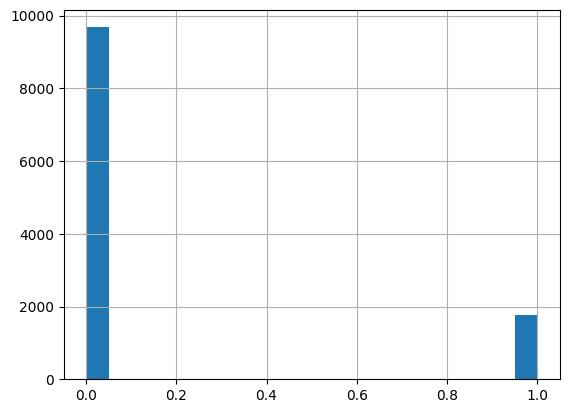

In [51]:
df.y.hist(bins=20);

Целевая переменная Revenue представляет собой булевой категориальный признак, указывающий на то, была ли совершена покупка или нет. Мы закодировали его значение в нуль и единицу и построили гистограмму распределения, которая выявила потенциальную проблема при построении моделей предсказания данной целевой переменной: несбалансированность (примерно 20/80). При таком распределении целевой переменной без применения специальных приёмов по выравниванию, с большой степенью вероятности модель будет выдавать прогноз 0 (отсутствие покупки), основываясь на частотности данного значения.   

## Распределение признаков

С распределением признаков значимых проблем не обнаружил, за исключением выбросов в ExitRates и BounceRates (см. ниже)

In [56]:
df.describe(include='object')

,Month,VisitorType
count,11448,11448
unique,11,3
top,May,Returning_Visitor
freq,3111,9797


In [55]:
df.Month.value_counts()

Month
May     3111
Nov     2773
Mar     1728
Dec     1594
Oct      502
Sep      426
Aug      414
Jul      399
June     264
Feb      169
aug       68
Name: count, dtype: int64

In [57]:
df.VisitorType.value_counts()

VisitorType
Returning_Visitor    9797
New_Visitor          1577
Other                  74
Name: count, dtype: int64

In [58]:
df.Browser.value_counts()

Browser
2     7365
1     2297
4      690
5      438
6      164
10     153
8      131
3       96
13      51
7       47
12      10
11       6
Name: count, dtype: int64

In [67]:
df.describe(exclude=np.number)

,Month,VisitorType,Weekend,Revenue
count,11448,11448,11448,11448
unique,11,3,2,2
top,May,Returning_Visitor,False,False
freq,3111,9797,8761,9678


In [23]:
import matplotlib.pyplot as plt
import seaborn as sns

In [80]:
ProfileReport(df, title = 'Profiling Report of the Shoppers Intention Dataset',
                html = {'style':{'full_width':True}})

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [82]:
# df.drop(columns='Revenue', inplace=True)

In [83]:
ProfileReport(df[['y', 'Administrative_Duration', 'Informational_Duration', 'ProductRelated_Duration', 'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay']], title='Profiling Report of the Shoppers Intention Dataset',
              html={'style': {'full_width': True}})

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Работа с выбросами в ExitRates и BounceRates 

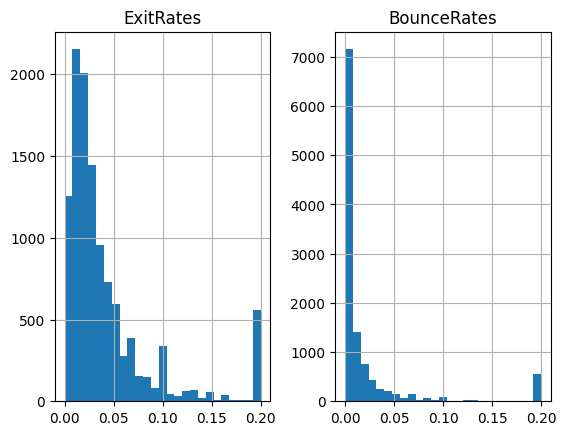

In [86]:
df[['ExitRates', 'BounceRates']].hist(bins=25);

Анализ графиков распределения признаков в ProfileReport выявил наличие выбросов в распределении признаков ExitRates и BounceRates. Уберём их путем отсечения данных выше квантилей 0.95 в данных признаках.

In [5]:
q = df[['ExitRates', 'BounceRates']].quantile(0.95)

In [6]:
q1 = df.ExitRates.quantile(0.95)
q2 = df.BounceRates.quantile(0.95)

In [93]:
q

ExitRates      0.177778
BounceRates    0.150000
Name: 0.95, dtype: float64

In [94]:
df[['ExitRates', 'BounceRates']]<q

,ExitRates,BounceRates
0,False,False
1,True,True
2,False,False
3,True,True
4,True,True
...,...,...
12325,True,True
12326,True,True
12327,True,True
12328,True,True


In [104]:
df.shape

(11448, 18)

In [7]:
df = df[(df.ExitRates<q1) & (df.BounceRates<q2)]

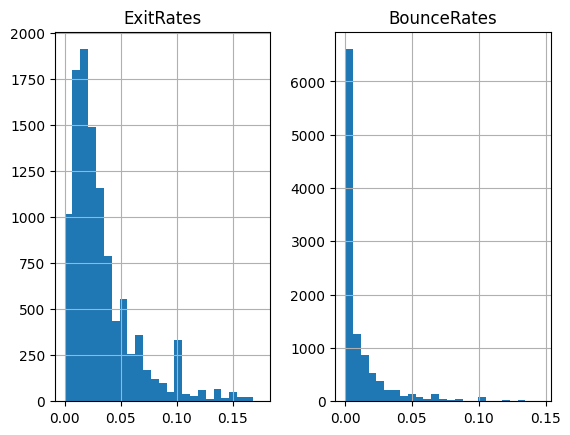

In [106]:
df[['ExitRates', 'BounceRates']].hist(bins=25);

С таким распределением можно работать в машинной обучении: логарифмирование с добавлением единицы позволит получить нормальное распределение данных величин.

# Корреляции

## Корреляция Пирсона - числовые корреляции

Заметим, что ProfileReport показывает наличие сильных корреляции между следующими числовыми признаками: df.Administrative и df.Administrative_Duration, df.Informational и df.Informational_Duration, df.ProductRelated и df.ProductRelated_Duration, df.BounceRates и df.ExitRates. При этом время проведения пользователем на целевых страницах кажется более содержательным признаком, чем количество посещенных целевых страниц. В этой связи, при оценке корреляции между целевой переменной и числовыми признаками, буду исключать связанные коррелирующие признаки df.Administrative, df.Informational, df.ProductRelated. Не могу оценить сравнительную важность между df.BounceRates и df.ExitRates, оставлю оба признака. 

In [75]:
df[['Administrative_Duration', 'Informational_Duration', 'ProductRelated_Duration', 'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay']]

,Administrative_Duration,Informational_Duration,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay
0,0.0,0.0,0.000000,0.200000,0.200000,0.000000,0.0
1,0.0,0.0,64.000000,0.000000,0.100000,0.000000,0.0
2,0.0,0.0,0.000000,0.200000,0.200000,0.000000,0.0
3,0.0,0.0,2.666667,0.050000,0.140000,0.000000,0.0
4,0.0,0.0,627.500000,0.020000,0.050000,0.000000,0.0
...,...,...,...,...,...,...,...
12325,145.0,0.0,1783.791667,0.007143,0.029031,12.241717,0.0
12326,0.0,0.0,465.750000,0.000000,0.021333,0.000000,0.0
12327,0.0,0.0,184.250000,0.083333,0.086667,0.000000,0.0
12328,75.0,0.0,346.000000,0.000000,0.021053,0.000000,0.0


<Axes: >

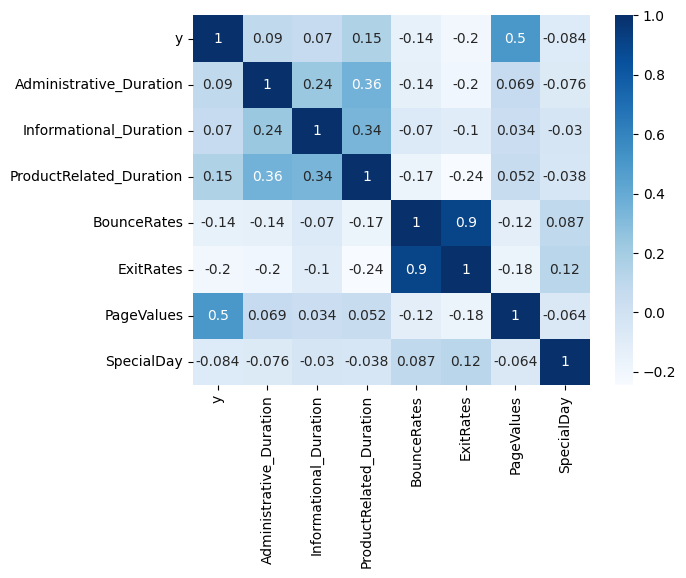

In [77]:
corr = df[['y', 'Administrative_Duration', 'Informational_Duration', 'ProductRelated_Duration', 'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay']].corr() # матрица корреляций

sns.heatmap(corr, cmap="Blues", annot=True)

In [78]:
df.Weekend = df.Weekend.map({True: 1, False: 0})

In [79]:
df.drop(columns='Revenue', inplace=True)

In [107]:
df.to_pickle('df_eda.pickle')

## V-мера Крамера - связь между категориальными признаками (статистики $\chi^2$)

In [9]:
df = pd.read_pickle('df_eda.pickle')

In [10]:
!pip install association-metrics -q

In [15]:
df.columns

Index(['Administrative', 'Administrative_Duration', 'Informational',
       'Informational_Duration', 'ProductRelated', 'ProductRelated_Duration',
       'BounceRates', 'ExitRates', 'PageValues', 'SpecialDay', 'Month',
       'OperatingSystems', 'Browser', 'Region', 'TrafficType', 'VisitorType',
       'Weekend', 'y'],
      dtype='object')

In [16]:
df['y', 'Month', 'VisitorType', 'Weekend']

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,OperatingSystems,Browser,Region,TrafficType,Weekend,y
count,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000,10855.000000
mean,2.455366,86.412490,0.535237,36.968065,33.511193,1267.081922,0.010940,0.032994,6.164373,0.060967,2.118194,2.359650,3.140949,4.032704,0.236757,0.162782
std,3.367598,183.316692,1.303716,146.559528,45.021067,1949.999481,0.019986,0.029064,18.602222,0.198300,0.890616,1.703137,2.398912,3.961713,0.425112,0.369184
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,9.000000,238.966667,0.000000,0.013390,0.000000,0.000000,2.000000,2.000000,1.000000,2.000000,0.000000,0.000000
50%,1.000000,16.000000,0.000000,0.000000,20.000000,666.000000,0.001812,0.024025,0.000000,0.000000,2.000000,2.000000,3.000000,2.000000,0.000000,0.000000
75%,4.000000,100.550000,0.000000,0.000000,40.000000,1553.640000,0.013333,0.041760,0.000000,0.000000,2.000000,2.000000,4.000000,4.000000,0.000000,0.000000
max,27.000000,3398.750000,24.000000,2549.375000,705.000000,63973.522230,0.146667,0.175000,361.763742,1.000000,8.000000,13.000000,9.000000,20.000000,1.000000,1.000000


In [21]:
import association_metrics as am

df_cat = df[['y', 'Month', 'VisitorType', 'Weekend']]
    
df_cat = df_cat.apply(lambda x: x.astype("category"))

cramersv = am.CramersV(df_cat)

cramersv.fit()

,y,Month,VisitorType,Weekend
y,1.000000,0.179200,0.101011,0.027385
Month,0.179200,1.000000,0.136454,0.072908
VisitorType,0.101011,0.136454,1.000000,0.048142
Weekend,0.027385,0.072908,0.048142,1.000000


<Axes: >

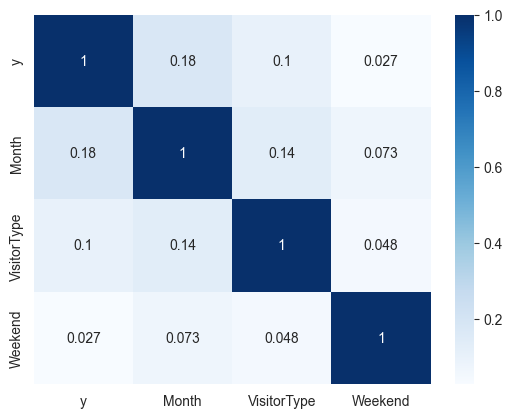

In [25]:
sns.heatmap(cramersv.fit(), cmap="Blues", annot=True)

Больше всего целевая переменная коррелирует с месяцем. Странно, наверное это как-то связано с наличием праздничных дней в месяцах.

## Anova - взаимосвязь между числовыми и категориальными признаками (F-тест)

In [26]:
from scipy.stats import f_oneway

In [27]:
Data = []

for c1 in df.columns:
    for c2 in df.columns:
        if df[c1].dtype == 'object' and df[c2].dtype != 'object':
            CategoryGroupLists = df.groupby(c1)[c2].apply(list)
            AnovaResults = f_oneway(*CategoryGroupLists)

            if AnovaResults[1] >= 0.05:
                Data.append({'Category' : c1, 'Numerical' : c2, 'Is correlated' : 'No'})
            else:
                Data.append({'Category' : c1, 'Numerical' : c2, 'Is correlated' : 'Yes'})

AnovaRes = pd.DataFrame.from_dict(Data)
AnovaRes

,Category,Numerical,Is correlated
0,Month,Administrative,Yes
1,Month,Administrative_Duration,Yes
2,Month,Informational,Yes
3,Month,Informational_Duration,Yes
4,Month,ProductRelated,Yes
5,Month,ProductRelated_Duration,Yes
6,Month,BounceRates,Yes
7,Month,ExitRates,Yes
8,Month,PageValues,Yes
9,Month,SpecialDay,Yes


Числовые признаки коррелированы с категориальным признаком "месяц". Нужно "подтягивать" другие категориальные признаки, но с учетом того, что корреляция между месяцем и этими признаками была установлена на предыдущем этапе, делать этого не стал

## Pandas Vs Polars

In [33]:
!pip install polars

import polars as pl

   ---------------------------------------- 0.0/24.2 MB ? eta -:--:--
   ---------------------------------------- 0.0/24.2 MB 1.4 MB/s eta 0:00:18
   ---------------------------------------- 0.1/24.2 MB 825.8 kB/s eta 0:00:30
   ---------------------------------------- 0.1/24.2 MB 1.0 MB/s eta 0:00:24
   ---------------------------------------- 0.3/24.2 MB 1.6 MB/s eta 0:00:15
    --------------------------------------- 0.3/24.2 MB 1.7 MB/s eta 0:00:15
    --------------------------------------- 0.6/24.2 MB 2.3 MB/s eta 0:00:11
   - -------------------------------------- 0.7/24.2 MB 2.5 MB/s eta 0:00:10
   - -------------------------------------- 0.8/24.2 MB 2.4 MB/s eta 0:00:10
   - -------------------------------------- 0.8/24.2 MB 2.0 MB/s eta 0:00:12
   - -------------------------------------- 1.0/24.2 MB 2.5 MB/s eta 0:00:10
   - -------------------------------------- 1.2/24.2 MB 2.5 MB/s eta 0:00:10
   -- ------------------------------------- 1.3/24.2 MB 2.4 MB/s eta 0:00:10
   -

In [29]:
df = pd.read_csv('https://raw.githubusercontent.com/aiedu-courses/stepik_eda_and_dev_tools/main/datasets/online_shoppers_intention.csv')

In [30]:
df.shape

(12330, 18)

In [31]:
df_big = df.copy()

for i in range(82):
  df_big = pd.concat([df_big, df])

df_big.to_csv("big_shoppers.csv", index=False)

In [32]:
df_big.shape

(1023390, 18)

### Загрузка данных

In [36]:
%%time

df_pl = pl.read_csv("big_shoppers.csv")

CPU times: total: 609 ms
Wall time: 126 ms


In [37]:
%%time

df_pd = pd.read_csv("big_shoppers.csv")

CPU times: total: 1.19 s
Wall time: 1.48 s


=> Polars значимо быстрее

### Фильтрация данных

In [38]:
df_pl.head()

Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
i64,f64,i64,f64,i64,f64,f64,f64,f64,f64,str,i64,i64,i64,i64,str,bool,bool
0,0.0,0,0.0,1,0.0,0.2,0.2,0.0,0.0,"""Feb""",1,1,1,1,"""Returning_Visi…",false,false
0,0.0,0,0.0,2,64.0,0.0,0.1,0.0,0.0,"""Feb""",2,2,1,2,"""Returning_Visi…",false,false
0,0.0,0,0.0,1,0.0,0.2,0.2,0.0,0.0,"""Feb""",4,1,9,3,"""Returning_Visi…",false,false
0,0.0,0,0.0,2,2.666667,0.05,0.14,0.0,0.0,"""Feb""",3,2,2,4,"""Returning_Visi…",false,false
0,0.0,0,0.0,10,627.5,0.02,0.05,0.0,0.0,"""Feb""",3,3,1,4,"""Returning_Visi…",true,false


In [40]:
%%time

df_pl[['Month', 'VisitorType', 'ProductRelated_Duration']]

CPU times: total: 0 ns
Wall time: 0 ns


Month,VisitorType,ProductRelated_Duration
str,str,f64
"""Feb""","""Returning_Visi…",0.0
"""Feb""","""Returning_Visi…",64.0
"""Feb""","""Returning_Visi…",0.0
"""Feb""","""Returning_Visi…",2.666667
"""Feb""","""Returning_Visi…",627.5
"""Feb""","""Returning_Visi…",154.216667
"""Feb""","""Returning_Visi…",0.0
"""Feb""","""Returning_Visi…",0.0
"""Feb""","""Returning_Visi…",37.0


In [41]:
%%time

df_pd[['Month', 'VisitorType', 'ProductRelated_Duration']]

CPU times: total: 0 ns
Wall time: 15.6 ms


,Month,VisitorType,ProductRelated_Duration
0,Feb,Returning_Visitor,0.000000
1,Feb,Returning_Visitor,64.000000
2,Feb,Returning_Visitor,0.000000
3,Feb,Returning_Visitor,2.666667
4,Feb,Returning_Visitor,627.500000
...,...,...,...
1023385,Dec,Returning_Visitor,1783.791667
1023386,Nov,Returning_Visitor,465.750000
1023387,Nov,Returning_Visitor,184.250000
1023388,Nov,Returning_Visitor,346.000000


Почему-то выборка Polars отражается как мгновенная (что, конечно, не так), в то время как Pandas отбирает те же столбцы за 15,6 ms 

In [44]:
%%time

df_pl.filter((pl.col('VisitorType') == 'Returning_Visitor') & (pl.col('ProductRelated_Duration') > 10))

CPU times: total: 188 ms
Wall time: 62.5 ms


Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
i64,f64,i64,f64,i64,f64,f64,f64,f64,f64,str,i64,i64,i64,i64,str,bool,bool
0,0.0,0,0.0,2,64.0,0.0,0.1,0.0,0.0,"""Feb""",2,2,1,2,"""Returning_Visi…",false,false
0,0.0,0,0.0,10,627.5,0.02,0.05,0.0,0.0,"""Feb""",3,3,1,4,"""Returning_Visi…",true,false
0,0.0,0,0.0,19,154.216667,0.015789,0.024561,0.0,0.0,"""Feb""",2,2,1,3,"""Returning_Visi…",false,false
0,0.0,0,0.0,2,37.0,0.0,null,0.0,0.8,"""Feb""",2,2,2,3,"""Returning_Visi…",false,false
0,0.0,0,0.0,3,738.0,0.0,0.022222,0.0,0.4,"""Feb""",2,4,1,2,"""Returning_Visi…",false,false
0,0.0,0,0.0,3,395.0,0.0,0.066667,0.0,0.0,"""Feb""",1,1,3,3,"""Returning_Visi…",false,false
0,0.0,0,0.0,16,407.75,0.01875,0.025833,0.0,0.4,"""Feb""",1,1,4,3,"""Returning_Visi…",false,false
0,0.0,0,0.0,7,280.5,0.0,0.028571,0.0,0.0,"""Feb""",1,1,1,3,"""Returning_Visi…",false,false
0,0.0,0,0.0,6,98.0,0.0,0.066667,0.0,0.0,"""Feb""",2,5,1,3,"""Returning_Visi…",false,false


In [45]:
%%time

df_pd[(df_pd.VisitorType == 'Returning_Visitor') & (df_pd.ProductRelated_Duration > 10)]

CPU times: total: 31.2 ms
Wall time: 121 ms


,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
1,0,0.0,0,0.0,2,64.000000,0.000000,0.100000,0.000000,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
4,0,0.0,0,0.0,10,627.500000,0.020000,0.050000,0.000000,0.0,Feb,3,3,1,4,Returning_Visitor,True,False
5,0,0.0,0,0.0,19,154.216667,0.015789,0.024561,0.000000,0.0,Feb,2,2,1,3,Returning_Visitor,False,False
8,0,0.0,0,0.0,2,37.000000,0.000000,NaN,0.000000,0.8,Feb,2,2,2,3,Returning_Visitor,False,False
9,0,0.0,0,0.0,3,738.000000,0.000000,0.022222,0.000000,0.4,Feb,2,4,1,2,Returning_Visitor,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1023384,0,0.0,1,0.0,16,503.000000,0.000000,0.037647,0.000000,0.0,Nov,2,2,1,1,Returning_Visitor,False,False
1023385,3,145.0,0,0.0,53,1783.791667,0.007143,0.029031,12.241717,0.0,Dec,4,6,1,1,Returning_Visitor,True,False
1023386,0,0.0,0,0.0,5,465.750000,0.000000,0.021333,0.000000,0.0,Nov,3,2,1,8,Returning_Visitor,True,False
1023387,0,0.0,0,0.0,6,184.250000,0.083333,0.086667,0.000000,0.0,Nov,3,2,1,13,Returning_Visitor,True,False


Провел несколько замеров с фильтрацией данных по числовому и категориальному столбцам: в среднем Pandas отрабатывал в 1.5-2 раза быстрее

### Агрегация

In [47]:
%%time

df_pd.groupby('Month').agg({'ExitRates' : 'mean', 'ProductRelated_Duration' : 'max'})

CPU times: total: 31.2 ms
Wall time: 49.9 ms


,ExitRates,ProductRelated_Duration
Month,,
Aug,0.037913,23342.082050
Dec,0.041277,63973.522230
Feb,0.073805,6951.972222
Jul,0.045678,23050.104140
June,0.058471,16093.309410
Mar,0.044530,12983.787710
May,0.048655,43171.233380
Nov,0.038165,27009.859430
Oct,0.028997,11976.721350


In [48]:
%%time

df_pl.groupby('Month').agg([pl.mean('ExitRates'), pl.max('ProductRelated_Duration')])

CPU times: total: 46.9 ms
Wall time: 46.8 ms


<timed eval>:1: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.


Month,ExitRates,ProductRelated_Duration
str,f64,f64
"""Aug""",0.037913,23342.08205
"""Mar""",0.04453,12983.78771
"""May""",0.048655,43171.23338
"""Nov""",0.038165,27009.85943
"""Feb""",0.073805,6951.972222
"""Sep""",0.030365,23888.81
"""Jul""",0.045678,23050.10414
"""Oct""",0.028997,11976.72135
"""Dec""",0.041277,63973.52223


=>Агрегация заняла примерно одинаковое время

In [51]:
# lazy operations
q = (
    df_pl
    .lazy()
    .groupby(by='Month')
    .agg(
        [
            pl.col('ExitRates').mean(),
            pl.col('ProductRelated_Duration').max()
        ]
    )
)

C:\Users\maxle\AppData\Local\Temp\ipykernel_9640\348864473.py:5: DeprecationWarning: `groupby` is deprecated. It has been renamed to `group_by`.
  .groupby(by='Month')


In [52]:
%%time

q.collect()

CPU times: total: 46.9 ms
Wall time: 46.9 ms


Month,ExitRates,ProductRelated_Duration
str,f64,f64
"""Feb""",0.073805,6951.972222
"""Mar""",0.04453,12983.78771
"""Dec""",0.041277,63973.52223
"""Sep""",0.030365,23888.81
"""Oct""",0.028997,11976.72135
"""June""",0.058471,16093.30941
"""May""",0.048655,43171.23338
"""Jul""",0.045678,23050.10414
"""aug""",0.042548,5731.094444


Неожиданно: lazy-запрос на агрегацию в Polars занял такое же время, как и обычный